<a href="https://colab.research.google.com/github/ShahKhalid1234/Cognifyz/blob/main/ResAnal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import files
restaurant_data = files.upload()

Saving Dataset .csv to Dataset  (1).csv


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import  seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Read the CSV file into a pandas DataFrame
data = pd.read_csv('Dataset .csv')


data.head(2)

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591


In [ ]:
#Convert Necessary strings to integer values
data['Has Table booking']= data['Has Table booking'].map({'Yes': 1,'No': 0})
data['Has Online delivery']= data['Has Online delivery'].map({'Yes': 1,'No': 0})
total_restaurants=len(data)
print(  "Total Number of Restaurants :", total_restaurants)
data.head(2)

Total Number of Restaurants : 9551


,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),1,0,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),1,0,No,No,3,4.5,Dark Green,Excellent,591


Determining the percentage of restaurants that offer table booking and online delivery.

In [ ]:
# percentages
table_booking_per=(data ['Has Table booking'] .sum() /total_restaurants) * 100

online_del_per=(data ['Has Online delivery'] .sum() /total_restaurants) * 100
print("Percentage of restaurants with table booking:", table_booking_per)
print("Percentage of restaurants with online delivery:", online_del_per)

Percentage of restaurants with table booking: 12.124384881164275
Percentage of restaurants with online delivery: 25.662234321013504


In [ ]:
print(data['Has Table booking'])

0       1
1       1
2       1
3       0
4       1
       ..
9546    0
9547    0
9548    0
9549    0
9550    0
Name: Has Table booking, Length: 9551, dtype: int64


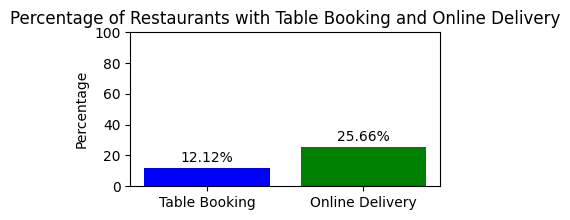

In [ ]:
import matplotlib.pyplot as plt

# Assuming 'data' is a DataFrame containing restaurant data and 'total_restaurants' is the total number of restaurants

# Calculate percentages
table_booking_per = (data['Has Table booking'].sum() / total_restaurants) * 100
online_del_per = (data['Has Online delivery'].sum() / total_restaurants) * 100

# Calculate number of restaurants
table_booking_count = data['Has Table booking'].sum()
online_del_count = data['Has Online delivery'].sum()

# Plot percentages
plt.figure(figsize=(4, 2))
plt.bar(['Table Booking', 'Online Delivery'], [table_booking_per, online_del_per], color=['blue', 'green'])
plt.ylabel('Percentage')
plt.title('Percentage of Restaurants with Table Booking and Online Delivery')
plt.ylim(0, 100)

# Add percentages above bars
for i, percentage in enumerate([table_booking_per, online_del_per]):
    plt.text(i, percentage + 2, f'{percentage:.2f}%', ha='center', va='bottom')

plt.show()



    Compare the average ratings of restaurantswith table booking and those without.

In [ ]:
print(data['Has Table booking'].unique())

[1 0]


In [ ]:
import pandas as pd

# Assuming 'data' is a DataFrame containing restaurant data

# Clean the 'Has Table booking' column if necessary


# Drop rows with missing 'Aggregate rating'
data.dropna(subset=['Aggregate rating'], inplace=True)

# Calculate average ratings for restaurants with table booking
avg_rating_with_table_booking = data[data['Has Table booking'] == 1]['Aggregate rating'].mean()

# Calculate average ratings for restaurants without table booking
avg_rating_without_table_booking = data[data['Has Table booking'] == 0]['Aggregate rating'].mean()

# Print the results
print("Average rating of restaurants with table booking:", avg_rating_with_table_booking)
print("Average rating of restaurants without table booking:", avg_rating_without_table_booking)


Average rating of restaurants with table booking: 3.4419689119170984
Average rating of restaurants without table booking: 2.559358989634219


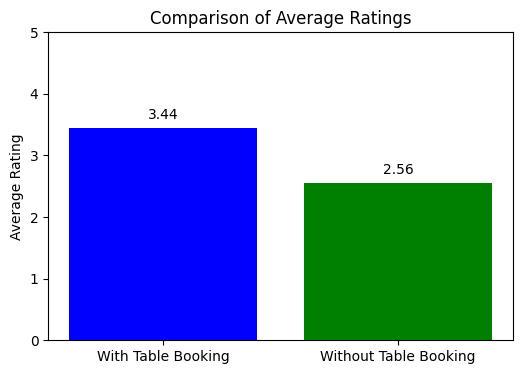

In [ ]:
import matplotlib.pyplot as plt

# Assuming 'data' is a DataFrame containing restaurant data

# Calculate average ratings for restaurants with table booking
avg_rating_with_table_booking = data[data['Has Table booking'] == 1]['Aggregate rating'].mean()

# Calculate average ratings for restaurants without table booking
avg_rating_without_table_booking = data[data['Has Table booking'] == 0]['Aggregate rating'].mean()

# Plot
plt.figure(figsize=(6, 4))
plt.bar(['With Table Booking', 'Without Table Booking'], [avg_rating_with_table_booking, avg_rating_without_table_booking], color=['blue', 'green'])
plt.ylabel('Average Rating')
plt.title('Comparison of Average Ratings')
plt.ylim(0, 5)  # Assuming rating is on a scale of 0 to 5

# Add annotations
for i, rating in enumerate([avg_rating_with_table_booking, avg_rating_without_table_booking]):
    plt.text(i, rating + 0.1, f'{rating:.2f}', ha='center', va='bottom')

plt.show()



In this bar plot:

The x-axis represents the two categories: "With Table Booking" and "Without Table Booking".
The y-axis represents the average rating.
Each bar represents the average rating for the respective category.
Annotations are added above each bar to display the exact average rating value.

    Analyze the availability of online deliveryamong restaurants with different price ranges

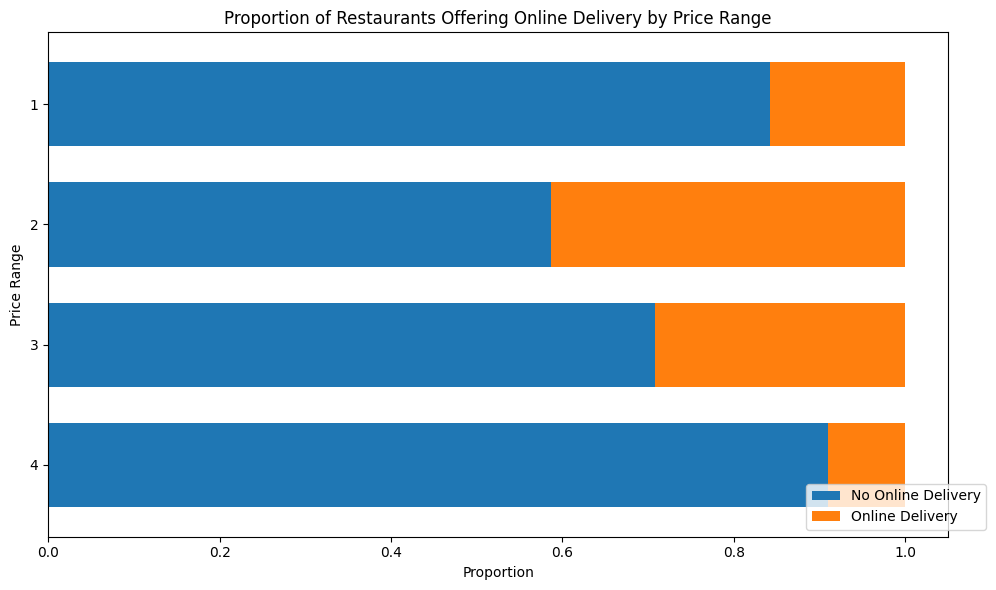

In [ ]:
import matplotlib.pyplot as plt

# Assuming 'data' is a DataFrame containing restaurant data

# Group data by price range and calculate the proportion of restaurants offering online delivery in each group
online_delivery_proportion = data.groupby('Price range')['Has Online delivery'].value_counts(normalize=True).unstack().fillna(0)

# Plot
fig, ax = plt.subplots(figsize=(10, 6))

# Create a stacked horizontal bar plot
online_delivery_proportion.plot(kind='barh', stacked=True, ax=ax, color=['#1f77b4', '#ff7f0e'], width=0.7)

# Set plot labels and title
ax.set_title('Proportion of Restaurants Offering Online Delivery by Price Range')
ax.set_xlabel('Proportion')
ax.set_ylabel('Price Range')

# Display the legend with customized labels
ax.legend(['No Online Delivery', 'Online Delivery'], loc='lower right', bbox_to_anchor=(1.05, 0))

# Invert y-axis to display higher price ranges at the top
plt.gca().invert_yaxis()

# Show the plot
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd

# Assuming 'data' is a DataFrame containing restaurant data

# Task 1: Determine the most common price range among all the restaurants
most_common_price_range = data['Price range'].mode()[0]
print("Most common price range among all the restaurants:", most_common_price_range)

# Task 2: Calculate the average rating for each price range
average_rating_by_price_range = data.groupby('Price range')['Aggregate rating'].mean()
print("Average rating for each price range:")
print(average_rating_by_price_range)

# Task 3: Identify the color that represents the highest average rating among different price ranges
highest_avg_rating_color = average_rating_by_price_range.idxmax()
print("Color representing the highest average rating:", highest_avg_rating_color)


Most common price range among all the restaurants: 1
Average rating for each price range:
Price range
1    1.999887
2    2.941054
3    3.683381
4    3.817918
Name: Aggregate rating, dtype: float64
Color representing the highest average rating: 4


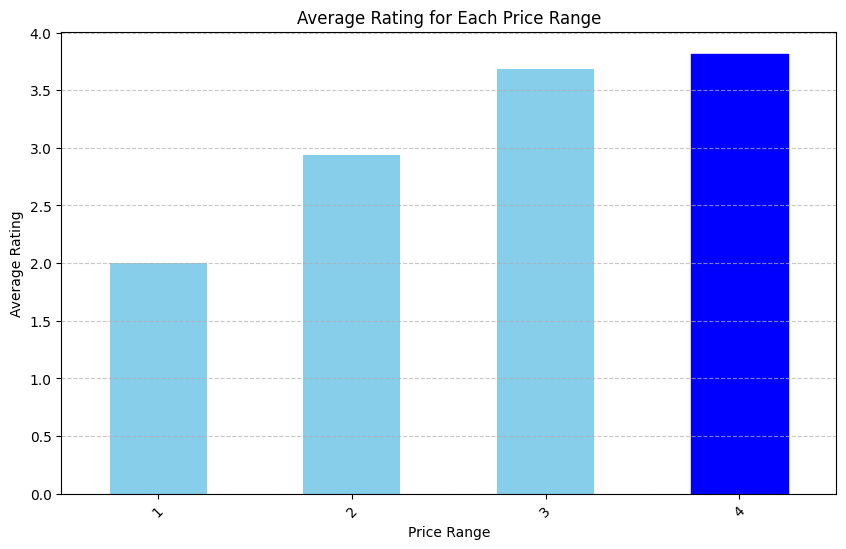

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'data' is a DataFrame containing restaurant data

# Calculate the average rating for each price range
average_rating_by_price_range = data.groupby('Price range')['Aggregate rating'].mean()

# Find the price range with the highest average rating
highest_avg_rating_price_range = average_rating_by_price_range.idxmax()

# Plot
plt.figure(figsize=(10, 6))
average_rating_by_price_range.plot(kind='bar', color='skyblue')  # Set default color to skyblue

# Highlight the price range with the highest average rating by setting its color to blue
plt.gca().patches[average_rating_by_price_range.index.get_loc(highest_avg_rating_price_range)].set_color('blue')

plt.title('Average Rating for Each Price Range')
plt.xlabel('Price Range')
plt.ylabel('Average Rating')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()


In [ ]:
from IPython.display import display
import pandas as pd

# Assuming 'data' is a DataFrame containing restaurant data

# Task 1: Extract additional features
data['Restaurant Name Length'] = data['Restaurant Name'].apply(len)
data['Address Length'] = data['Address'].apply(len)

# Task 2: Create new features by encoding categorical variables
data['Has Table Booking'] = (data['Has Table booking'] == 'Yes').astype(int)
data['Has Online Delivery'] = (data['Has Online delivery'] == 'Yes').astype(int)

# Styling the DataFrame
styled_data = data.style.set_properties(**{'text-align': 'center'})\
                       .set_caption('Updated Restaurant Data with New Features')\
                       .background_gradient(cmap='Blues', subset=['Restaurant Name Length', 'Address Length'])\
                       .applymap(lambda x: 'color: green' if x == 1 else '', subset=['Has Table Booking', 'Has Online Delivery'])

# Display the styled DataFrame
display(styled_data)
